In [1]:
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import cm
import numpy as np
from netCDF4 import Dataset
from plot_picture_function import set_map_ticks,add_Chinese_provinces
from datetime import timedelta
import cartopy.crs as ccrs

In [13]:
ds1 = xr.open_dataset(r'H:\ZiYuanPingGu\result2\01.nc')#读取经过处理的1月份数据，下同
ds4 = xr.open_dataset(r'H:\ZiYuanPingGu\result2\04.nc')
ds7 = xr.open_dataset(r'H:\ZiYuanPingGu\result2\07.nc')
ds10 = xr.open_dataset(r'H:\ZiYuanPingGu\result2\10.nc')

In [3]:
# month_l = ['01', '04', '07', '10']
# data_l = ['e5', 'm2', 'j5']
# dataname = ['ERA5', 'MERRA2', 'JRA55']
# Bias_LWP = []#与LWP同样的操作，下同
# Bias_IWP = []

# #预创建一个4×4的空list
# LWP_list = []
# IWP_list = []



# for month in month_l:
#     for i in range(len(data_l)):
#         bar_ = xr.open_dataset(fr'H:\ZiYuanPingGu\result2022\res{data_l[i]}_{month}.nc')
#         if i == 0:
#             H8_lwp = bar_['H8_lwp_mm'].data
#             H8_iwp = bar_['H8_iwp_mm'].data
#             LWP_list.append(H8_lwp)
#             IWP_list.append(H8_iwp)
#         lwp = bar_[f'{dataname[i]}_lwp_mm'].data
#         iwp = bar_[f'{dataname[i]}_iwp_mm'].data
#         print(f'{dataname[i]}_biaslwp_mm', month)
#         bias_lwp = bar_[f'{dataname[i]}_biaslwp_mm'].data
#         # print(bias_lwp.max())
#         bias_iwp = bar_[f'{dataname[i]}_biasiwp_mm'].data
#         LWP_list.append(lwp)
#         IWP_list.append(iwp)
#         Bias_LWP.append(bias_lwp)
#         # print(Bias_LWP[0].max())
#         Bias_IWP.append(bias_iwp)
#         bar_.close()


    # MERRA2_ = xr.open_dataset(fr'H:\ZiYuanPingGu\result2022\resm2_{month}.nc')
    # JRA55_ = xr.open_dataset(fr'H:\ZiYuanPingGu\result2022\resj5_{month}.nc')

ERA5_biaslwp_mm 01
MERRA2_biaslwp_mm 01
JRA55_biaslwp_mm 01
ERA5_biaslwp_mm 04
MERRA2_biaslwp_mm 04
JRA55_biaslwp_mm 04
ERA5_biaslwp_mm 07
MERRA2_biaslwp_mm 07
JRA55_biaslwp_mm 07
ERA5_biaslwp_mm 10
MERRA2_biaslwp_mm 10
JRA55_biaslwp_mm 10


In [4]:
def Sum_monthlydata(data_list, row, dataname):
    if dataname == 'H8':
        index = 0
    elif dataname == 'ERA5':
        index = 1
    elif dataname == 'MERRA2':
        index = 2
    else:
        index=3
    All_res = np.zeros(data_list[index].shape)
    for mon in range(4):
        All_res += data_list[index + mon*row].copy()
    return All_res

def Sum_biasdata(data_list, row, dataname):
    if dataname == 'ERA5':
        index = 0
    elif dataname == 'MERRA2':
        index = 1
    else:
        index=2
    All_res = np.zeros(data_list[index].shape)
    for mon in range(4):
        All_res += data_list[index + mon*row].copy()
    return All_res

In [14]:
Bias_LWP = []#与LWP同样的操作，下同
Bias_IWP = []
ds = [ds1, ds4, ds7, ds10]


for i in range(len(ds)):
    # Bias_LWP.append(ds[i].H8_lwp_mm)
    Bias_LWP.append(ds[i].bias_ERA5lwp)
    Bias_LWP.append(ds[i].bias_MERRA2lwp)
    Bias_LWP.append(ds[i].bias_JRA55lwp)
    
    
    # Bias_IWP.append(ds[i].H8_iwp_mm)
    Bias_IWP.append(ds[i].bias_ERA5iwp)
    Bias_IWP.append(ds[i].bias_MERRA2iwp)
    Bias_IWP.append(ds[i].bias_JRA55iwp)
    

In [15]:
#预创建一个4×4的空list
LWP_list = []
IWP_list = []
# ds = [ds1, ds4, ds7, ds10]
for i in range(len(ds)):
    LWP_list.append(ds[i].H8_lwp_mm)
    LWP_list.append(ds[i].ERA5_lwp_mm)
    LWP_list.append(ds[i].MERRA2_lwp_mm)
    LWP_list.append(ds[i].JRA55_lwp_mm)
    
    IWP_list.append(ds[i].H8_iwp_mm)
    IWP_list.append(ds[i].ERA5_iwp_mm)
    IWP_list.append(ds[i].MERRA2_iwp_mm)
    IWP_list.append(ds[i].JRA55_iwp_mm)
    

In [16]:
H8_lwp_all = Sum_monthlydata(LWP_list, 4, 'H8')
ERA5_lwp_all = Sum_monthlydata(LWP_list, 4, 'ERA5')
MERRA2_lwp_all = Sum_monthlydata(LWP_list, 4, 'MERRA2')
JRA55_lwp_all = Sum_monthlydata(LWP_list, 4, 'JRA55')

H8_iwp_all = Sum_monthlydata(IWP_list, 4, 'H8')
ERA5_iwp_all = Sum_monthlydata(IWP_list, 4, 'ERA5')
MERRA2_iwp_all = Sum_monthlydata(IWP_list, 4, 'MERRA2')
JRA55_iwp_all = Sum_monthlydata(IWP_list, 4, 'JRA55')

ERA5_biaslwp_all = Sum_biasdata(Bias_LWP, 3, 'ERA5')
MERRA2_biaslwp_all = Sum_biasdata(Bias_LWP, 3, 'MERRA2')
JRA55_biaslwp_all = Sum_biasdata(Bias_LWP, 3, 'JRA55')

ERA5_biasiwp_all = Sum_biasdata(Bias_IWP, 3, 'ERA5')
MERRA2_biasiwp_all = Sum_biasdata(Bias_IWP, 3, 'MERRA2')
JRA55_biasiwp_all = Sum_biasdata(Bias_IWP, 3, 'JRA55')

New_LWP_list = [H8_lwp_all, ERA5_lwp_all, MERRA2_lwp_all, JRA55_lwp_all] + LWP_list
New_IWP_list = [H8_iwp_all, ERA5_iwp_all, MERRA2_iwp_all, JRA55_iwp_all] + IWP_list

New_Bias_LWP = [ERA5_biaslwp_all, MERRA2_biaslwp_all, JRA55_biaslwp_all] + Bias_LWP
New_Bias_IWP = [ERA5_biasiwp_all, MERRA2_biasiwp_all, JRA55_biasiwp_all] + Bias_IWP

In [50]:
def Plots_sc1(solution, data, picname):#自定义绘图
    fig = plt.figure(figsize=(10,13), dpi=600)
    month = ['All','Jan','Apr','Jul','Oct']
    dataname = ["ERA5", "MERRA-2", "JRA-55"]
    axs = []
    
    for j in range(5):
        for i in range(len(picname)):
#             print(j, i)
            ynum = (55/solution[i])+1
            xnum = (40/solution[i])+1
            y = np.linspace(80, 135, int(ynum))
            x = np.linspace(55, 15, int(xnum))

            ###------
            if i == 0:
                mask = np.zeros(data[0].shape)
                N25 = np.where(x == 25)[0][0]
                N30 = np.where(x == 30)[0][0]
                E85 = np.where(y == 85)[0][0]
                E98 = np.where(y == 98)[0][0]
                mask[N30:N25+1, E85:E98+1] = 1
                mask_bool = mask.astype(bool)
                temp = data[0].data
                area = temp[mask_bool]
                print(np.nanmean(area[area > 0.6]))
            ###------
            X_array, Y_array = np.meshgrid(y, x)
            extent = [80, 135, 15, 55]
            proj = ccrs.PlateCarree()#选择投影方式，平面投影
            ax1 = fig.add_subplot(5,3,j*3+i+1, projection = proj)#创建一个轴，或者是说主体
            # 设置经纬度刻度.
            set_map_ticks(ax1, dx=10, dy=10, nx=1, ny=1, labelsize='small')#自定义函数set_map_tick
            ax1.set_extent(extent, crs=proj)
            # title1 = str(dataset1.time.dt.strftime("%Y-%m-%d %H:%M").data)
#             ax1.set_title(picname[i], fontsize=12, loc='left')
            levels = np.linspace(-0.6, 0.6, 11)
            # print(i,j)
            im1 = ax1.contourf(X_array, Y_array, data[3*j+i], levels=levels, cmap='coolwarm', extend='both')#ERA5_clc_CHN[6,:,:]
            add_Chinese_provinces(ax1, lw=0.8, ec='gray', fc='none')#后两个参数是设置eagecolor,facecolor,linewigth线宽
            #设置图标
#             if j == 0:
#                 ax1.set_title(picname[i], fontsize=15)
#             if i == 0:
#                 ax1.set_ylabel(month[j], fontsize=15)
#             #到了最后一行，绘制colorbar。
#             if j == 3:
#                 cax1 = fig.add_axes([ax1.get_position().x0, ax1.get_position().y0-0.04, 
#                                      ax1.get_position().x1-ax1.get_position().x0, 0.01])#预留colorbar的空间
#                 cb = plt.colorbar(im1, cax=cax1,label='kg·m$^-$$^2$', orientation='horizontal')#水平放置
            axs.append(ax1)
            xlabel = '('+chr(ord('a')+i+j*5)+')'+' '+month[j]+'_'+dataname[i]
            ax1.set_xlabel(xlabel, fontsize=12)
    plt.subplots_adjust(wspace=0.25, hspace=0.35)
    cb = plt.colorbar(im1, ax=axs,label='kg·m$^-$$^2$', orientation='horizontal', fraction=0.02, pad=0.05)

0.7970435413060133
0.7970435413060133
0.7970435413060133
0.7970435413060133
0.7970435413060133


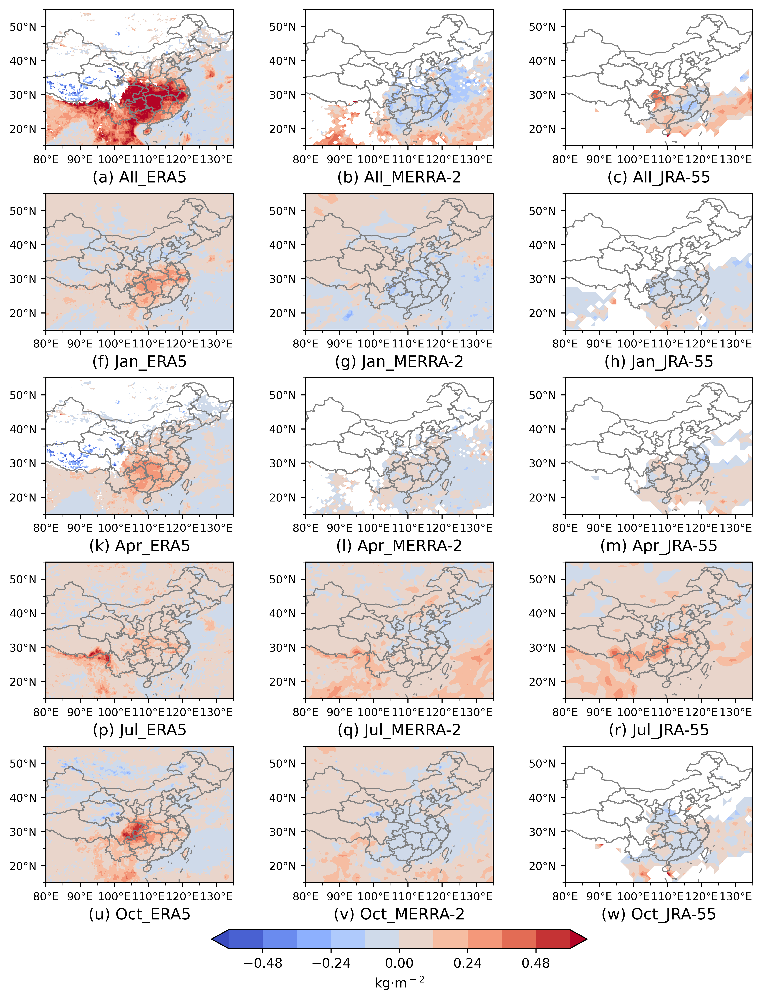

In [51]:
Plots_sc1([0.25,0.5,1.25], New_Bias_LWP, ['ERA5','MERRA2','JRA55'])

In [11]:
def Plots_sc(solution, data, picname):
    fig = plt.figure(figsize=(12,12), dpi=600)
    dataname = ["H8", "ERA5", "MERRA-2", "JRA-55"]
    month = ['ALL', 'Jan','Apr','Jul','Oct']
    axs = []
    for j in range(5):
        for i in range(4):
            ynum = (55/solution[i])+1
            xnum = (40/solution[i])+1
            y = np.linspace(80, 135, int(ynum))
            x = np.linspace(55, 15, int(xnum))
            X_array, Y_array = np.meshgrid(y, x)
            extent = [80, 135, 15, 55]
            proj = ccrs.PlateCarree()#选择投影方式，平面投影
            ax1 = fig.add_subplot(5,4,j*4+i+1, projection = proj)#创建一个轴，或者是说主体
            # 设置经纬度刻度.
            set_map_ticks(ax1, dx=20, dy=10, nx=1, ny=1, labelsize='small')#自定义函数set_map_tick
            ax1.set_extent(extent, crs=proj)
            # title1 = str(dataset1.time.dt.strftime("%Y-%m-%d %H:%M").data)
#             ax1.set_title(picname[i], fontsize=12, loc='left')
            levels = np.linspace(0, 0.6, 11)
            # if i == 0:
            #     levels = np.linspace(0, 1.2, 11)
            # else:
            #     levels = np.linspace(0, 0.12, 11)
            im1 = ax1.contourf(X_array, Y_array, data[4*j+i], levels=levels, cmap='rainbow', extend='max')#ERA5_clc_CHN[6,:,:]
            add_Chinese_provinces(ax1, lw=0.8, ec='gray', fc='none')#后两个参数是设置eagecolor,facecolor,linewigth线宽
#             if j == 0:
#                 ax1.set_title(picname[i], fontsize=15)
#             if i == 0:
#                 ax1.set_ylabel(month[j], fontsize=15)
#             if j == 3:
#                 cax1 = fig.add_axes([ax1.get_position().x0, ax1.get_position().y0-0.04, 
#                                      ax1.get_position().x1-ax1.get_position().x0, 0.01])
            axs.append(ax1)
            xlabel = '('+chr(ord('a')+i+j*4)+')'+' '+month[j]+'_'+dataname[i]
            ax1.set_xlabel(xlabel, fontsize=12)
    plt.subplots_adjust(wspace=0.1, hspace=0.35)
    cb = plt.colorbar(im1, ax=axs,label='kg·m$^-$$^2$', orientation='horizontal', fraction=0.02, pad=0.08)
    
#                 cb.set_ticklabels(np.round(np.linspace(0, 480, 11), -1))
#                 cb.ax.tick_params(labelsize=6) #设置colorbar刻度字体大小
#                 if i > 0:
#                     cb = plt.colorbar(im1, cax=cax1,label='10$^-$$^1$ kg·m$^-$$^2$', orientation='horizontal')
#                     cb.set_ticklabels(np.linspace(0, 0.6, 11))


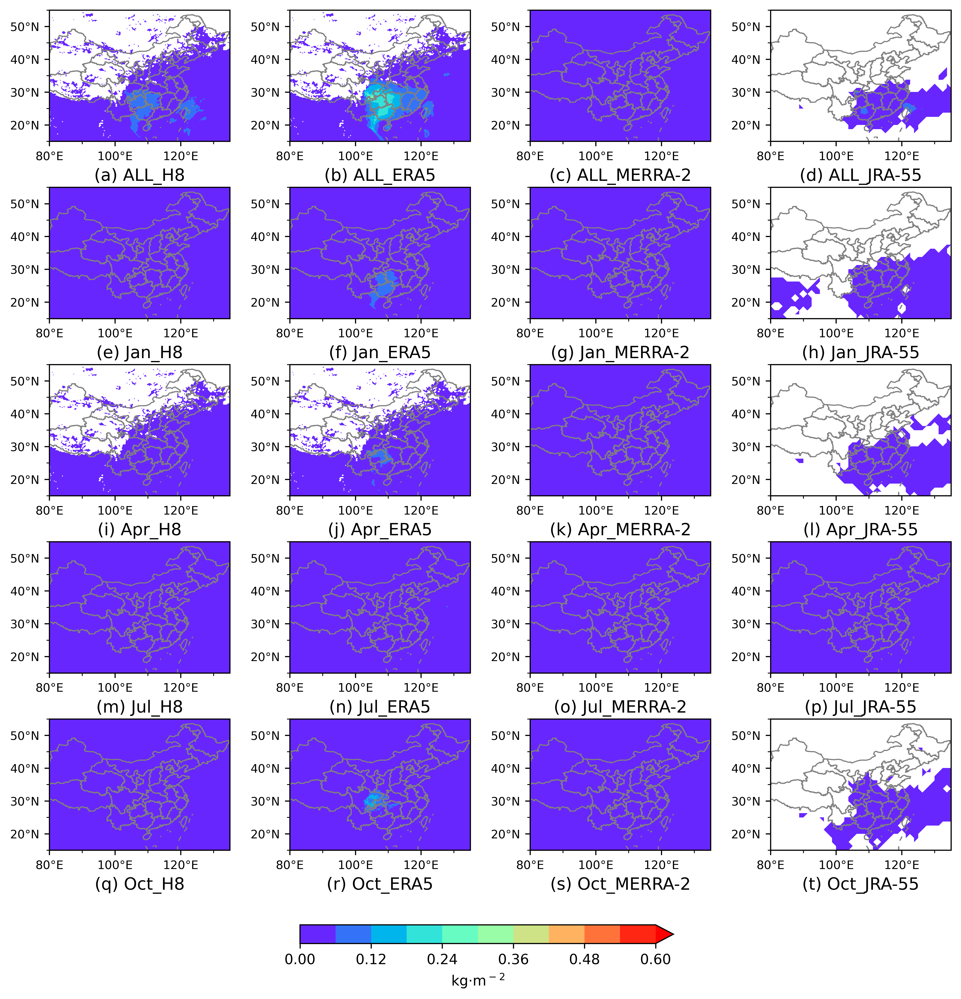

In [12]:
Plots_sc([0.25,0.25,0.5,1.25], New_LWP_list, ['H8','ERA5','MERRA2','JRA55'])

In [138]:
def Plots_sci(solution, data, picname):
    fig = plt.figure(figsize=(12,12), dpi=600)
    dataname = ["H8", "ERA5", "MERRA-2", "JRA-55"]
    month = ['ALL', 'Jan','Apr','Jul','Oct']
    axs = []
    for j in range(5):
        for i in range(4):
            ynum = (55/solution[i])+1
            xnum = (40/solution[i])+1
            y = np.linspace(80, 135, int(ynum))
            x = np.linspace(55, 15, int(xnum))
            X_array, Y_array = np.meshgrid(y, x)
            extent = [80, 135, 15, 55]
            proj = ccrs.PlateCarree()#选择投影方式，平面投影
            ax1 = fig.add_subplot(5,4,j*4+i+1, projection = proj)#创建一个轴，或者是说主体
            # 设置经纬度刻度.
            set_map_ticks(ax1, dx=20, dy=10, nx=1, ny=1, labelsize='small')#自定义函数set_map_tick
            ax1.set_extent(extent, crs=proj)
            # title1 = str(dataset1.time.dt.strftime("%Y-%m-%d %H:%M").data)
#             ax1.set_title(picname[i], fontsize=12, loc='left')
            # levels = np.linspace(0, 0.1, 11)
            if i == 0:
                levels = np.linspace(0, 0.2, 11)
            else:
                levels = np.linspace(0, 0.02, 11)
            im1 = ax1.contourf(X_array, Y_array, data[4*j+i], levels=levels, cmap='rainbow', extend='max')#ERA5_clc_CHN[6,:,:]
            add_Chinese_provinces(ax1, lw=0.8, ec='gray', fc='none')#后两个参数是设置eagecolor,facecolor,linewigth线宽
#             if j == 0:
#                 ax1.set_title(picname[i], fontsize=15)
#             if i == 0:
#                 ax1.set_ylabel(month[j], fontsize=15)
            xlabel = '('+chr(ord('a')+i+j*4)+')'+' '+month[j]+'_'+dataname[i]
            ax1.set_xlabel(xlabel, fontsize=12)
            if j == 4:
                cax1 = fig.add_axes([ax1.get_position().x0, ax1.get_position().y0-0.06, 
                                     ax1.get_position().x1-ax1.get_position().x0, 0.01])
                if i > 0:
                    cb = plt.colorbar(im1, cax=cax1,label='10$^-$$^1$ kg·m$^-$$^2$', orientation='horizontal')
                    cb.set_ticklabels(np.linspace(0, 0.2, 11))
                else:
                    cb = plt.colorbar(im1, cax=cax1,label='kg·m$^-$$^2$', orientation='horizontal')
            # axs.append(ax1)
            
    plt.subplots_adjust(wspace=0.1, hspace=0.35)
    # cb = plt.colorbar(im1, ax=axs,label='kg·m$^-$$^2$', orientation='horizontal', fraction=0.02, pad=0.08)
    
#                 cb.set_ticklabels(np.round(np.linspace(0, 480, 11), -1))
#                 cb.ax.tick_params(labelsize=6) #设置colorbar刻度字体大小
                

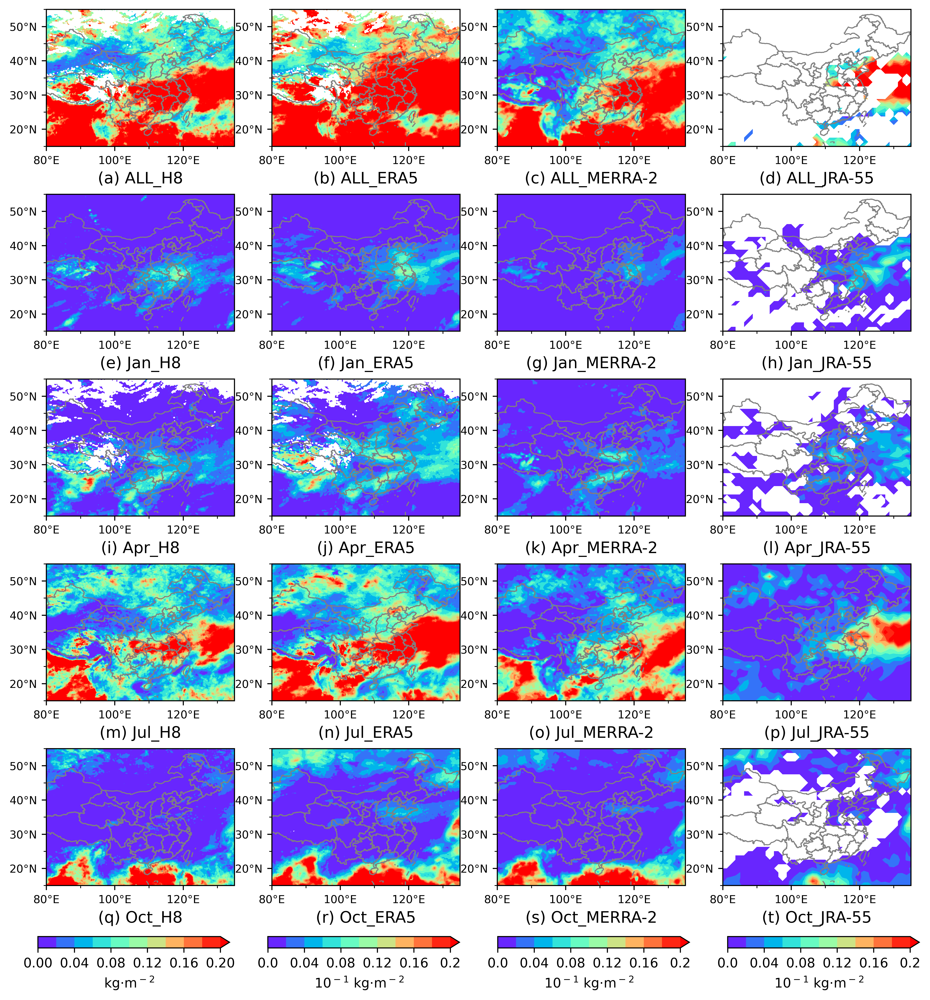

In [139]:
Plots_sci([0.25,0.25,0.5,1.25], New_IWP_list, ['H8','ERA5','MERRA2','JRA55'])

In [8]:
def Plots_Apr2(solution, data, picname):
    fig = plt.figure(figsize=(12,6), dpi=600)
    dataname = ["H8", "ERA5", "JRA55", "MERRA2"]
    month = ['Jan','Apr','Jul','Oct']
    axs = []
    for j in range(1):
        for i in range(4):
            ynum = (55/solution[i])+1
            xnum = (40/solution[i])+1
            y = np.linspace(80, 135, int(ynum))
            x = np.linspace(55, 15, int(xnum))
            X_array, Y_array = np.meshgrid(y, x)
            extent = [80, 135, 15, 55]
            proj = ccrs.PlateCarree()#选择投影方式，平面投影
            ax1 = fig.add_subplot(1,4,j*4+i+1, projection = proj)#创建一个轴，或者是说主体
            # 设置经纬度刻度.
            set_map_ticks(ax1, dx=10, dy=10, nx=1, ny=1, labelsize='small')#自定义函数set_map_tick
            ax1.set_extent(extent, crs=proj)

            levels = np.linspace(0, 0.6, 11)

            im1 = ax1.contourf(X_array, Y_array, data[4*0+i], levels=levels, cmap='rainbow', extend='max')#ERA5_clc_CHN[6,:,:]
            add_Chinese_provinces(ax1, lw=0.8, ec='gray', fc='none')#后两个参数是设置eagecolor,facecolor,linewigth线宽

            axs.append(ax1)
            xlabel = '('+chr(ord('a')+i+j*4)+')'+' '+month[1]+'-'+dataname[i]
            ax1.set_xlabel(xlabel, fontsize=12)
    plt.subplots_adjust(wspace=0.2, hspace=0.1)
    cb = plt.colorbar(im1, ax=axs,label='kg·m$^-$$^2$', orientation='horizontal', fraction=0.05, pad=0.15)

In [12]:
# Plots_sc1([0.25,1.25,0.5], Bias_IWP, ['ERA5','JRA55','MERRA2'])

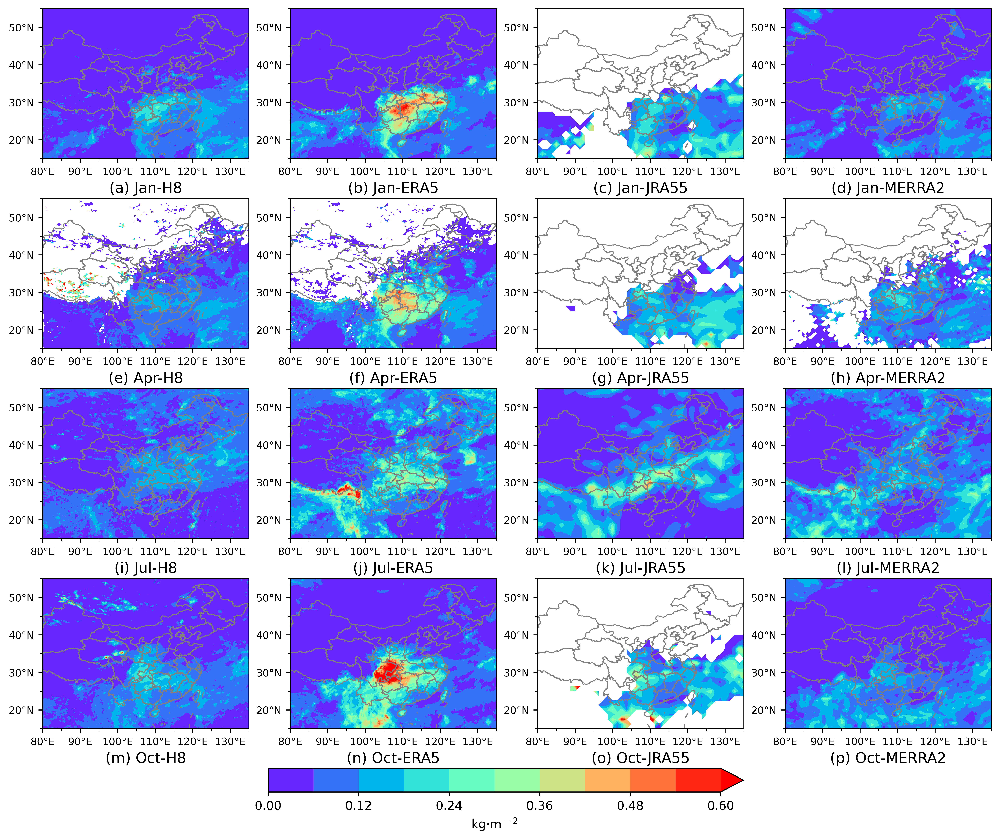

In [13]:
Plots_sc([0.25,0.25,1.25,0.5], LWP_list, ['H8','ERA5','JRA55','MERRA2'])

In [14]:
# Plots_sc([0.25,0.25,1.25,0.5], IWP_list, ['H8','ERA5','JRA55','MERRA2'])